In [1]:
# Import necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [15]:
# Load your dataset and weather data
dataset = pd.read_csv('/content/Checkpoint_count.csv')
weather_data = pd.read_csv('/content/weather.csv')

In [16]:
dataset

,Date,Time,check_point0,check_point1,check_point2,check_point3,check_point4,check_point5,check_point6,check_point7,...,check_point11,check_point12,check_point13,check_point14,check_point15,check_point16,check_point17,check_point18,check_point19,check_point20
0,1/1/2015,0:00,58,12,4,17,33.0,49,21,16,...,NaN,58,91,24,3,NaN,17,78,21,6
1,2/1/2015,0:00,75,7,5,15,30.0,113,27,9,...,NaN,109,177,32,13,NaN,11,57,77,4
2,3/1/2015,0:00,79,7,3,7,30.0,107,36,12,...,NaN,71,131,33,5,NaN,14,174,40,5
3,4/1/2015,0:00,10,1,21,0,10.0,35,29,1,...,NaN,6,11,6,1,NaN,1,20,6,0
4,5/1/2015,0:00,42,0,2,0,27.0,90,21,1,...,NaN,0,5,49,20,NaN,0,41,56,10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
314,11/11/2015,0:00,3044,1931,2828,1393,NaN,3603,1754,1142,...,950.0,2328,3280,1210,338,4065.0,1534,1527,2860,356
315,12/11/2015,0:00,1751,930,1670,888,NaN,2048,700,675,...,467.0,1345,1877,755,180,2336.0,960,955,1777,198
316,13/11/2015,0:00,1818,906,1711,873,NaN,2115,634,477,...,482.0,1416,1980,719,204,2628.0,978,1040,1727,258
317,14/11/2015,0:00,979,759,978,322,NaN,1112,290,310,...,266.0,1061,1448,269,70,1876.0,640,805,737,73


In [17]:
weather_data

,Date/Time,Year,Month,Day,Data Quality,Max Temp (°C),Max Temp Flag,Min Temp (°C),Min Temp Flag,Mean Temp (°C),...,Total Snow (cm),Total Snow Flag,Total Precip (mm),Total Precip Flag,Snow on Grnd (cm),Snow on Grnd Flag,Dir of Max Gust (10s deg),Dir of Max Gust Flag,Spd of Max Gust (km/h),Spd of Max Gust Flag
0,1/1/2015,2015,1,1,‡,-3.0,NaN,-7.6,NaN,-5.3,...,1.8,NaN,1.8,NaN,0.0,NaN,22.0,NaN,63,NaN
1,1/2/2015,2015,1,2,‡,-3.4,NaN,-14.2,NaN,-8.8,...,0.0,T,0.0,T,1.0,NaN,27.0,NaN,50,NaN
2,1/3/2015,2015,1,3,‡,-8.5,NaN,-17.7,NaN,-13.1,...,17.0,NaN,17.0,NaN,1.0,NaN,3.0,NaN,41,NaN
3,1/4/2015,2015,1,4,‡,3.0,NaN,-8.6,NaN,-2.8,...,0.4,NaN,27.2,NaN,8.0,NaN,26.0,NaN,69,NaN
4,1/5/2015,2015,1,5,‡,-5.3,NaN,-17.9,NaN,-11.6,...,0.0,T,0.0,T,6.0,NaN,27.0,NaN,74,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
360,12/27/2015,2015,12,27,‡,1.9,NaN,-4.1,NaN,-1.1,...,2.6,NaN,13.4,NaN,1.0,NaN,3.0,NaN,44,NaN
361,12/28/2015,2015,12,28,‡,-4.1,NaN,-10.9,NaN,-7.5,...,0.0,T,0.0,T,2.0,NaN,30.0,NaN,44,NaN
362,12/29/2015,2015,12,29,‡,-7.5,NaN,-12.1,NaN,-9.8,...,39.2,NaN,39.2,NaN,7.0,NaN,NaN,NaN,<31,NaN
363,12/30/2015,2015,12,30,‡,-5.1,NaN,-9.2,NaN,-7.2,...,5.6,NaN,3.4,NaN,16.0,NaN,NaN,NaN,<31,NaN


In [18]:
# Assumption: You have a 'Date' column in both datasets.
# Convert 'Date' column to datetime type
dataset['Date'] = pd.to_datetime(dataset['Date'])
weather_data['Date/Time'] = pd.to_datetime(weather_data['Date/Time'])

<ipython-input-18-828721014bce>:3: UserWarning: Parsing dates in DD/MM/YYYY format when dayfirst=False (the default) was specified. This may lead to inconsistently parsed dates! Specify a format to ensure consistent parsing.
  dataset['Date'] = pd.to_datetime(dataset['Date'])


In [19]:
# Create the target variable by summing cycles rented from all checkpoints
dataset['TargetVariable'] = dataset.iloc[:, 2:].sum(axis=1)

In [20]:
print(dataset.isnull().sum())

Date                0
Time                0
check_point0        0
check_point1        0
check_point2        0
check_point3        0
check_point4      257
check_point5        0
check_point6        0
check_point7        0
check_point8        0
check_point9      267
check_point10       0
check_point11     110
check_point12       0
check_point13       0
check_point14       0
check_point15       0
check_point16     269
check_point17       0
check_point18       0
check_point19       0
check_point20       0
TargetVariable      0
dtype: int64


In [21]:
# impute missing values with the mean for numerical columns
dataset.fillna(dataset.mean(), inplace=True)

<ipython-input-21-58b4cc346d48>:2: FutureWarning: DataFrame.mean and DataFrame.median with numeric_only=None will include datetime64 and datetime64tz columns in a future version.
  dataset.fillna(dataset.mean(), inplace=True)
<ipython-input-21-58b4cc346d48>:2: FutureWarning: The default value of numeric_only in DataFrame.mean is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.
  dataset.fillna(dataset.mean(), inplace=True)


In [22]:
print(dataset.isnull().sum())

Date              0
Time              0
check_point0      0
check_point1      0
check_point2      0
check_point3      0
check_point4      0
check_point5      0
check_point6      0
check_point7      0
check_point8      0
check_point9      0
check_point10     0
check_point11     0
check_point12     0
check_point13     0
check_point14     0
check_point15     0
check_point16     0
check_point17     0
check_point18     0
check_point19     0
check_point20     0
TargetVariable    0
dtype: int64


Now Missing values is fully removed

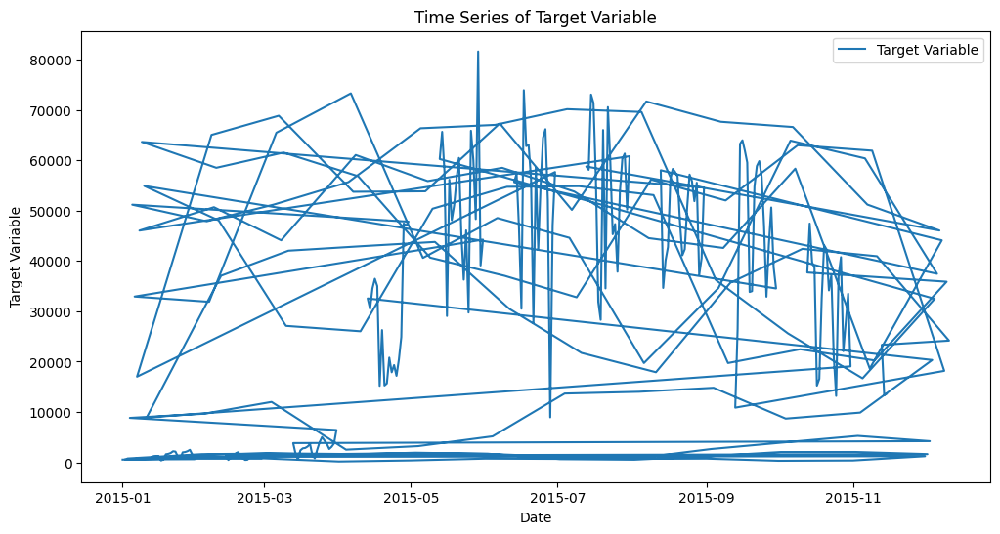

In [23]:
#Time Series Analysis

# Assumption: You want to visualize the target variable over time.
# Plot the time series of the target variable
plt.figure(figsize=(12, 6))
plt.plot(dataset['Date'], dataset['TargetVariable'], label='Target Variable')
plt.xlabel('Date')
plt.ylabel('Target Variable')
plt.title('Time Series of Target Variable')
plt.legend()
plt.show()

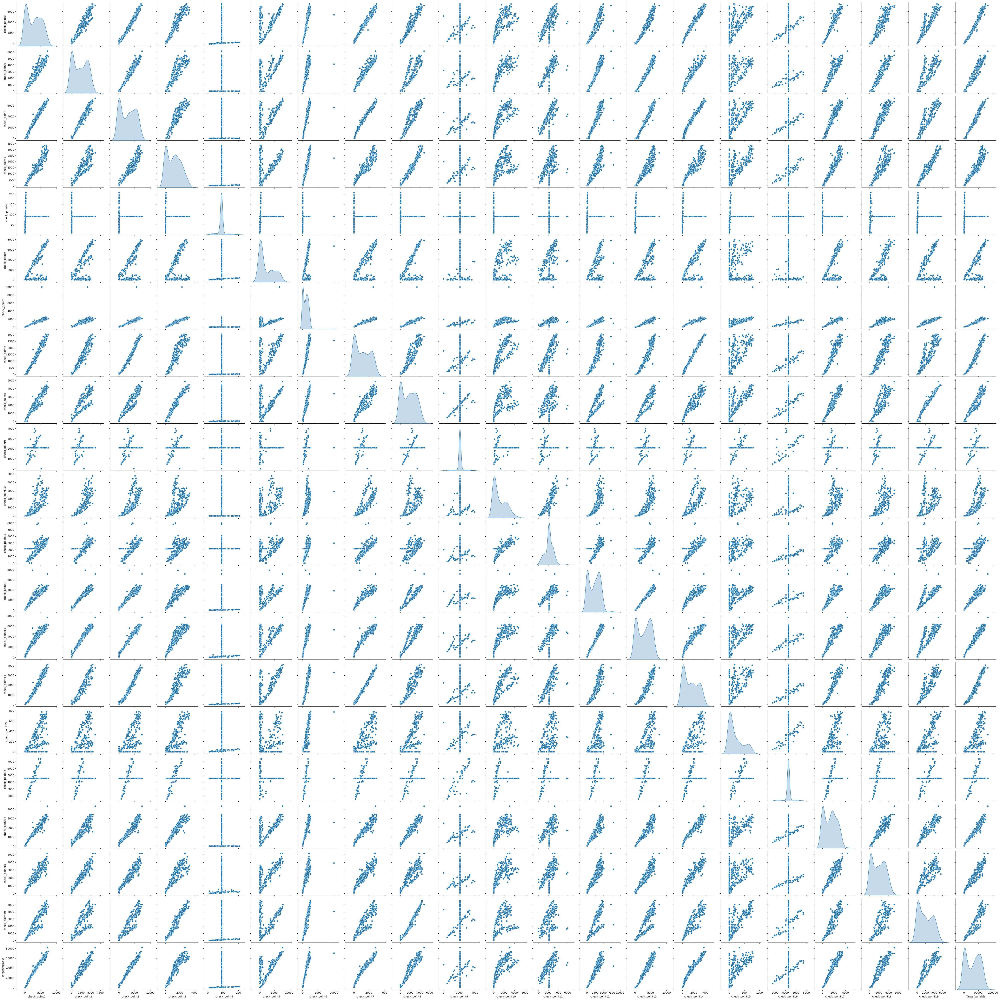

In [24]:
#Feature Analysis

# Create a pair plot to visualize relationships between features and the target variable
# Include all 20 checkpoints
feature_columns = ['check_point{}'.format(i) for i in range(20)]
sns.pairplot(dataset[feature_columns + ['TargetVariable']], diag_kind='kde')
plt.show()

In [25]:
# Calculate correlations between features and the target variable
correlations = dataset[feature_columns + ['TargetVariable']].corr()
print(correlations['TargetVariable'])

check_point0      0.989071
check_point1      0.973818
check_point2      0.992431
check_point3      0.958500
check_point4      0.009909
check_point5      0.695207
check_point6      0.865196
check_point7      0.983145
check_point8      0.966466
check_point9      0.157138
check_point10     0.825217
check_point11     0.444290
check_point12     0.957532
check_point13     0.983752
check_point14     0.978818
check_point15     0.701927
check_point16     0.197831
check_point17     0.976462
check_point18     0.959041
check_point19     0.936119
TargetVariable    1.000000
Name: TargetVariable, dtype: float64


Most of the checkpoints (check_point0 through check_point19) exhibit high positive correlations with each other. This suggests that there is a strong linear relationship between the number of cycles rented at these different checkpoints.

check_point4 has a very low correlation (0.009909) with the TargetVariable, indicating that it may not be strongly related to the total number of cycles rented. This could be due to an outlier or a specific pattern associated with check_point4.

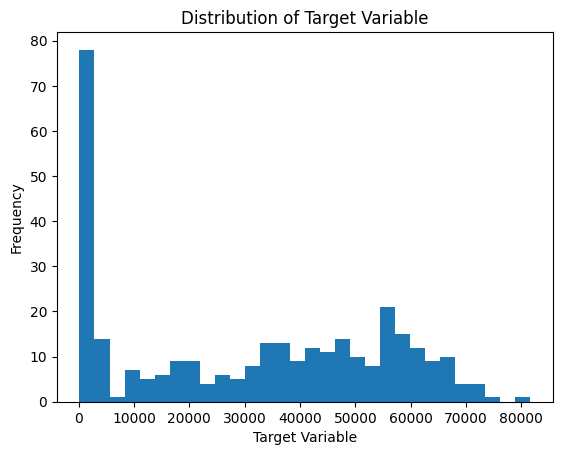

In [26]:
# Create a histogram to visualize the distribution of the target variable
plt.hist(dataset['TargetVariable'], bins=30)
plt.xlabel('Target Variable')
plt.ylabel('Frequency')
plt.title('Distribution of Target Variable')
plt.show()

In [27]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 319 entries, 0 to 318
Data columns (total 24 columns):
 #   Column          Non-Null Count  Dtype         
---  ------          --------------  -----         
 0   Date            319 non-null    datetime64[ns]
 1   Time            319 non-null    object        
 2   check_point0    319 non-null    int64         
 3   check_point1    319 non-null    int64         
 4   check_point2    319 non-null    int64         
 5   check_point3    319 non-null    int64         
 6   check_point4    319 non-null    float64       
 7   check_point5    319 non-null    int64         
 8   check_point6    319 non-null    int64         
 9   check_point7    319 non-null    int64         
 10  check_point8    319 non-null    int64         
 11  check_point9    319 non-null    float64       
 12  check_point10   319 non-null    int64         
 13  check_point11   319 non-null    float64       
 14  check_point12   319 non-null    int64         
 15  check_

In [28]:
dataset.describe()

,check_point0,check_point1,check_point2,check_point3,check_point4,check_point5,check_point6,check_point7,check_point8,check_point9,...,check_point12,check_point13,check_point14,check_point15,check_point16,check_point17,check_point18,check_point19,check_point20,TargetVariable
count,319.000000,319.000000,319.000000,319.000000,319.000000,319.000000,319.000000,319.000000,319.000000,319.000000,...,319.000000,319.000000,319.000000,319.000000,319.000000,319.000000,319.000000,319.000000,319.000000,319.000000
mean,2915.398119,2212.909091,2859.485893,1167.388715,89.935484,2208.031348,1011.175549,1137.316614,1754.257053,2090.250000,...,2207.626959,2939.294671,1477.206897,207.476489,4563.180000,1387.119122,1903.363636,2023.708464,295.347962,31329.429467
std,2276.281648,1832.808709,2337.531344,960.020397,22.725304,2452.475658,917.450049,991.065590,1415.004315,389.554801,...,1660.936427,2105.774880,1254.990855,231.009131,654.582678,1070.781272,1376.375755,1632.368428,248.947624,23781.986862
min,10.000000,0.000000,0.000000,0.000000,10.000000,2.000000,8.000000,0.000000,0.000000,0.000000,...,0.000000,5.000000,0.000000,0.000000,1554.000000,0.000000,20.000000,6.000000,0.000000,158.000000
25%,387.500000,3.500000,33.000000,54.500000,89.935484,214.500000,119.000000,25.500000,61.000000,2090.250000,...,324.500000,513.000000,159.500000,15.500000,4563.180000,244.500000,457.000000,352.500000,47.000000,3163.500000
50%,3044.000000,2180.000000,3011.000000,1162.000000,89.935484,689.000000,1049.000000,1067.000000,1787.000000,2090.250000,...,2361.000000,3169.000000,1422.000000,107.000000,4563.180000,1519.000000,1855.000000,1762.000000,267.000000,34529.000000
75%,4968.000000,3937.000000,5088.000000,1948.000000,89.935484,4114.500000,1675.000000,2094.500000,3025.500000,2090.250000,...,3658.000000,4797.000000,2676.000000,337.000000,4563.180000,2237.000000,3111.000000,3539.000000,526.000000,53764.000000
max,7387.000000,6153.000000,7322.000000,3334.000000,207.000000,7905.000000,9999.000000,3035.000000,4867.000000,3997.000000,...,7921.000000,7695.000000,4118.000000,781.000000,7388.000000,4342.000000,5166.000000,5596.000000,820.000000,81618.000000


<Axes: >

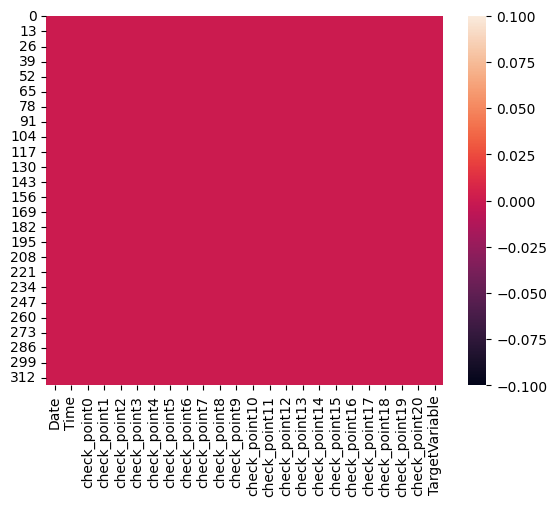

In [29]:
sns.heatmap(dataset.isnull())

In [30]:
# Check the outliers
from scipy import stats
# Specify the threshold for considering values as outliers (e.g., z-score > 3 or < -3)
threshold = 3

# Create an empty DataFrame to store outliers
outliers_df = pd.DataFrame()

# Iterate through each feature column (excluding non-numeric columns like Date and Time and target variable)
for column in dataset.columns:
    if column != 'TargetVariable' and dataset[column].dtype in ['int64', 'float64']:
        # Calculate the z-scores for the current feature
        z_scores = stats.zscore(dataset[column])

        # Find the rows where z-scores exceed the threshold for outliers
        feature_outliers = dataset[abs(z_scores) > threshold]

        # Add the detected outliers to the outliers DataFrame
        outliers_df = pd.concat([outliers_df, feature_outliers], axis=0)

# Display the outliers
print(outliers_df)

          Date  Time  check_point0  check_point1  check_point2  check_point3  \
3   2015-04-01  0:00            10             1            21             0   
10  2015-11-01  0:00            66             4             2             4   
21  2015-01-22  0:00           278            17             5            52   
22  2015-01-23  0:00           307             8             7            45   
26  2015-01-27  0:00           276             1             2            51   
27  2015-01-28  0:00           335             0            12            51   
28  2015-01-29  0:00           327            10            38            65   
38  2015-08-02  0:00            36             3             0             0   
41  2015-11-02  0:00           300             0             7             0   
48  2015-02-18  0:00           261             0            19            30   
57  2015-02-27  0:00           248             0             5             1   
202 2015-07-22  0:00          5396      

In [31]:
import numpy as np

# List of columns with potential outliers (update this list as needed)
columns_with_outliers = ['check_point4', 'check_point12', 'check_point16']

# Apply log transformation to the specified columns
for column in columns_with_outliers:
    # Create a boolean mask to identify rows with outliers in the column
    is_outlier = dataset[column].isin(outliers_df[column])

    # Apply the log transformation to the column (adding 1 to avoid log(0))
    dataset.loc[is_outlier, column] = np.log1p(dataset.loc[is_outlier, column])

This code will replace the values in the specified columns for rows identified as outliers with their log-transformed counterparts.

In [32]:
import matplotlib.pyplot as plt
import scipy.stats as stats

# Select numeric columns for feature analysis (excluding Date, Time, and TargetVariable columns)
feature_columns = dataset.select_dtypes(include=['int64', 'float64']).drop(columns=['TargetVariable'])

# Create subplots to display histograms and Q-Q plots
fig, axes = plt.subplots(nrows=len(feature_columns), ncols=2, figsize=(12, 2 * len(feature_columns)))

# Iterate through feature columns and plot skewness histograms and Q-Q plots
for i, column in enumerate(feature_columns):
    # Calculate skewness
    skew_value = stats.skew(dataset[column].dropna())

    # Plot histogram
    axes[i, 0].hist(dataset[column].dropna(), bins=20, color='blue', alpha=0.7)
    axes[i, 0].set_title(f'{column} (Skewness: {skew_value:.2f})')

    # Plot Q-Q plot
    stats.probplot(dataset[column].dropna(), dist="norm", plot=axes[i, 1])
    axes[i, 1].set_title(f'Q-Q Plot')

plt.tight_layout()
plt.show()

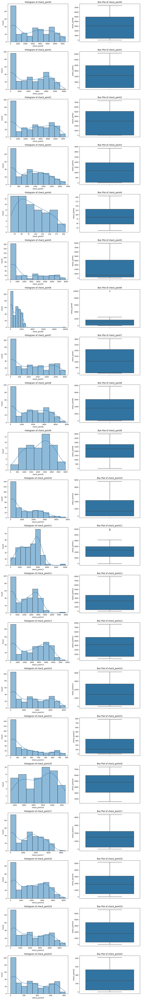

In [33]:
# Univariate Analysis
# Select the features you want to analyze
selected_features = [
    'check_point0', 'check_point1', 'check_point2', 'check_point3', 'check_point4',
    'check_point5', 'check_point6', 'check_point7', 'check_point8', 'check_point9',
    'check_point10', 'check_point11', 'check_point12', 'check_point13', 'check_point14',
    'check_point15', 'check_point16', 'check_point17', 'check_point18', 'check_point19',
    'check_point20'
]

# Set up the subplots for visualizing the features
num_plots = len(selected_features)
fig, axes = plt.subplots(num_plots, 2, figsize=(12, num_plots * 4))

# Loop through selected features for analysis
for i, feature in enumerate(selected_features):
    # Plot a histogram
    sns.histplot(data=rental_checkpoint_data, x=feature, ax=axes[i, 0], kde=True)
    axes[i, 0].set_title(f'Histogram of {feature}')

    # Plot a box plot to detect outliers
    sns.boxplot(data=rental_checkpoint_data, y=feature, ax=axes[i, 1])
    axes[i, 1].set_title(f'Box Plot of {feature}')

# Adjust spacing between subplots
plt.tight_layout()

# Show the plots
plt.show()

Observe the skewness of the distributions. Positive skewness indicates a right-skewed distribution (long tail on the right), while negative skewness indicates a left-skewed distribution (long tail on the left).

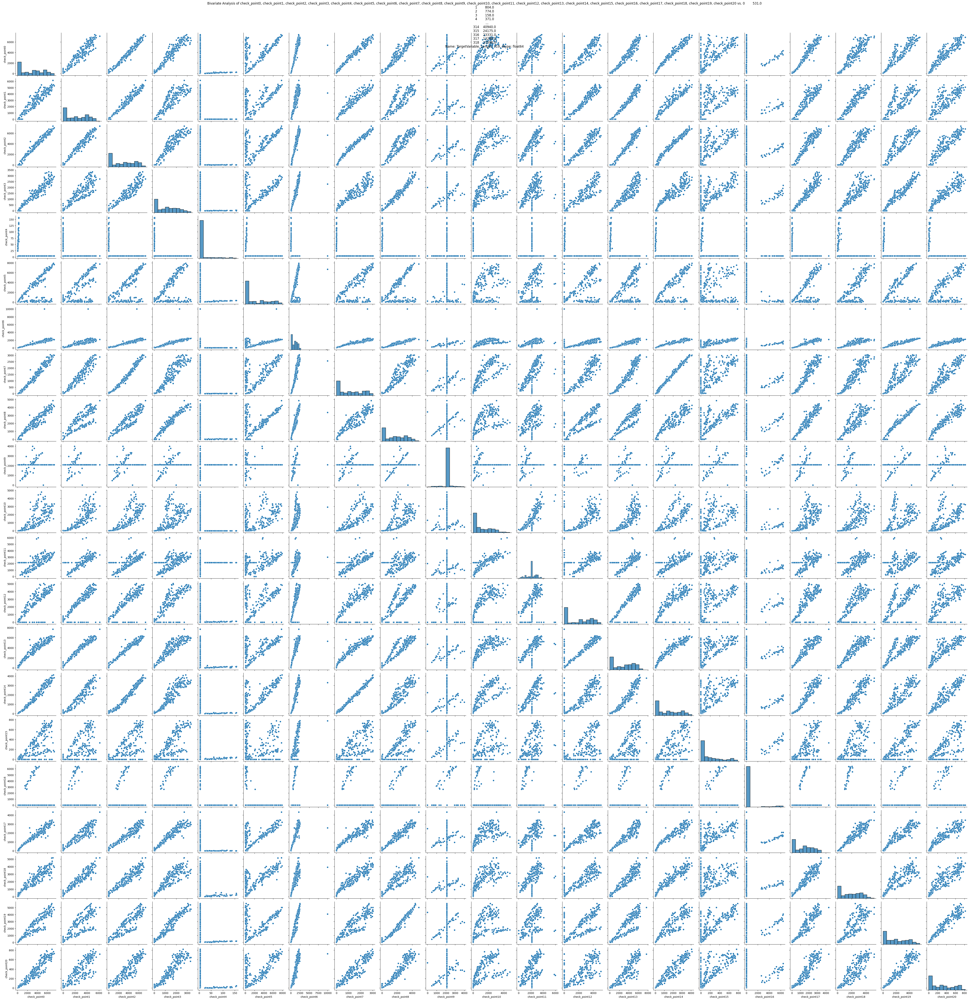

In [35]:
# Bivariate Analysis
# Select a target variable (e.g., 'TargetVariable') and features for bivariate analysis
target_variable = dataset['TargetVariable']
selected_features = [
    'check_point0', 'check_point1', 'check_point2', 'check_point3', 'check_point4',
    'check_point5', 'check_point6', 'check_point7', 'check_point8', 'check_point9',
    'check_point10', 'check_point11', 'check_point12', 'check_point13', 'check_point14',
    'check_point15', 'check_point16', 'check_point17', 'check_point18', 'check_point19',
    'check_point20'
]

# Create a pairplot to visualize relationships
sns.pairplot(data=dataset, vars=selected_features, kind='scatter')
plt.suptitle(f'Bivariate Analysis of {", ".join(selected_features)} vs. {target_variable}', y=1.02)
plt.show()

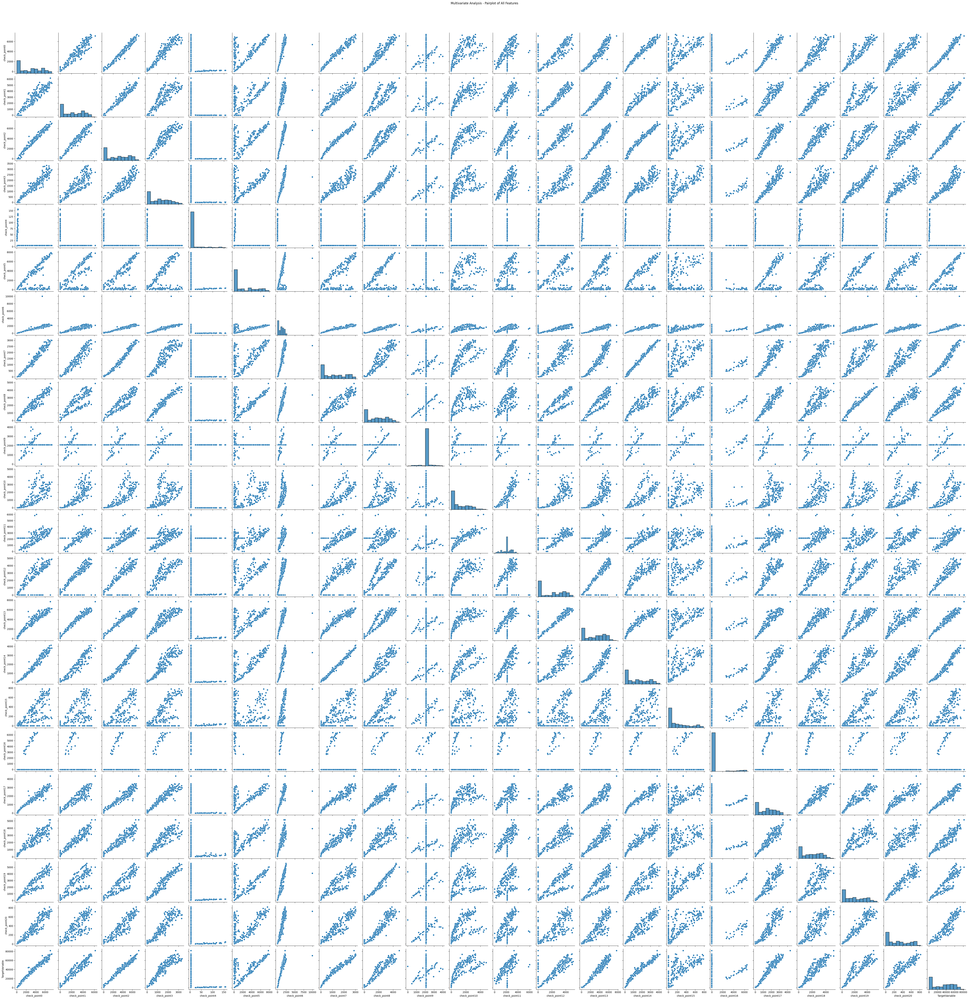

In [36]:
# Multi Variate Analysis
# Create a pairplot for all features
sns.pairplot(dataset)
plt.suptitle('Multivariate Analysis - Pairplot of All Features', y=1.02)
plt.show()

In [37]:
# for weather data
print(weather_data.isnull().sum())

Date/Time                      0
Year                           0
Month                          0
Day                            0
Data Quality                   0
Max Temp (°C)                  0
Max Temp Flag                365
Min Temp (°C)                  0
Min Temp Flag                364
Mean Temp (°C)                 0
Mean Temp Flag               364
Heat Deg Days (°C)             0
Heat Deg Days Flag           364
Cool Deg Days (°C)             0
Cool Deg Days Flag           364
Total Rain (mm)               13
Total Rain Flag              322
Total Snow (cm)                4
Total Snow Flag              332
Total Precip (mm)             10
Total Precip Flag            302
Snow on Grnd (cm)            256
Snow on Grnd Flag            365
Dir of Max Gust (10s deg)     82
Dir of Max Gust Flag         364
Spd of Max Gust (km/h)         1
Spd of Max Gust Flag         364
dtype: int64


In [38]:
# impute missing values with the mean for numerical columns
weather_data.fillna(weather_data.mean(), inplace=True)

<ipython-input-38-2105876653c0>:2: FutureWarning: DataFrame.mean and DataFrame.median with numeric_only=None will include datetime64 and datetime64tz columns in a future version.
  weather_data.fillna(weather_data.mean(), inplace=True)
<ipython-input-38-2105876653c0>:2: FutureWarning: The default value of numeric_only in DataFrame.mean is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.
  weather_data.fillna(weather_data.mean(), inplace=True)


In [39]:
print(weather_data.isnull().sum())

Date/Time                      0
Year                           0
Month                          0
Day                            0
Data Quality                   0
Max Temp (°C)                  0
Max Temp Flag                365
Min Temp (°C)                  0
Min Temp Flag                364
Mean Temp (°C)                 0
Mean Temp Flag               364
Heat Deg Days (°C)             0
Heat Deg Days Flag           364
Cool Deg Days (°C)             0
Cool Deg Days Flag           364
Total Rain (mm)                0
Total Rain Flag              322
Total Snow (cm)                0
Total Snow Flag              332
Total Precip (mm)              0
Total Precip Flag            302
Snow on Grnd (cm)              0
Snow on Grnd Flag            365
Dir of Max Gust (10s deg)      0
Dir of Max Gust Flag         364
Spd of Max Gust (km/h)         1
Spd of Max Gust Flag         364
dtype: int64


In [40]:
# Create binary indicator variables for flag columns
flag_columns = ['Max Temp Flag', 'Min Temp Flag', 'Mean Temp Flag', 'Heat Deg Days Flag', 'Cool Deg Days Flag',
                'Total Rain Flag', 'Total Snow Flag', 'Total Precip Flag', 'Snow on Grnd Flag', 'Dir of Max Gust Flag', 'Spd of Max Gust Flag']

for flag_column in flag_columns:
    weather_data[flag_column + '_missing'] = weather_data[flag_column].isnull().astype(int)

# Drop the original flag columns
weather_data.drop(flag_columns, axis=1, inplace=True)

In [41]:
weather_data

,Date/Time,Year,Month,Day,Data Quality,Max Temp (°C),Min Temp (°C),Mean Temp (°C),Heat Deg Days (°C),Cool Deg Days (°C),...,Min Temp Flag_missing,Mean Temp Flag_missing,Heat Deg Days Flag_missing,Cool Deg Days Flag_missing,Total Rain Flag_missing,Total Snow Flag_missing,Total Precip Flag_missing,Snow on Grnd Flag_missing,Dir of Max Gust Flag_missing,Spd of Max Gust Flag_missing
0,2015-01-01,2015,1,1,‡,-3.0,-7.6,-5.3,23.3,0.0,...,1,1,1,1,1,1,1,1,1,1
1,2015-01-02,2015,1,2,‡,-3.4,-14.2,-8.8,26.8,0.0,...,1,1,1,1,1,0,0,1,1,1
2,2015-01-03,2015,1,3,‡,-8.5,-17.7,-13.1,31.1,0.0,...,1,1,1,1,1,1,1,1,1,1
3,2015-01-04,2015,1,4,‡,3.0,-8.6,-2.8,20.8,0.0,...,1,1,1,1,1,1,1,1,1,1
4,2015-01-05,2015,1,5,‡,-5.3,-17.9,-11.6,29.6,0.0,...,1,1,1,1,1,0,0,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
360,2015-12-27,2015,12,27,‡,1.9,-4.1,-1.1,19.1,0.0,...,1,1,1,1,1,1,1,1,1,1
361,2015-12-28,2015,12,28,‡,-4.1,-10.9,-7.5,25.5,0.0,...,1,1,1,1,1,0,0,1,1,1
362,2015-12-29,2015,12,29,‡,-7.5,-12.1,-9.8,27.8,0.0,...,1,1,1,1,1,1,1,1,1,1
363,2015-12-30,2015,12,30,‡,-5.1,-9.2,-7.2,25.2,0.0,...,1,1,1,1,1,1,1,1,1,1


In [42]:
print(weather_data.isnull().sum())

Date/Time                       0
Year                            0
Month                           0
Day                             0
Data Quality                    0
Max Temp (°C)                   0
Min Temp (°C)                   0
Mean Temp (°C)                  0
Heat Deg Days (°C)              0
Cool Deg Days (°C)              0
Total Rain (mm)                 0
Total Snow (cm)                 0
Total Precip (mm)               0
Snow on Grnd (cm)               0
Dir of Max Gust (10s deg)       0
Spd of Max Gust (km/h)          1
Max Temp Flag_missing           0
Min Temp Flag_missing           0
Mean Temp Flag_missing          0
Heat Deg Days Flag_missing      0
Cool Deg Days Flag_missing      0
Total Rain Flag_missing         0
Total Snow Flag_missing         0
Total Precip Flag_missing       0
Snow on Grnd Flag_missing       0
Dir of Max Gust Flag_missing    0
Spd of Max Gust Flag_missing    0
dtype: int64


In [44]:
weather_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 365 entries, 0 to 364
Data columns (total 27 columns):
 #   Column                        Non-Null Count  Dtype         
---  ------                        --------------  -----         
 0   Date/Time                     365 non-null    datetime64[ns]
 1   Year                          365 non-null    int64         
 2   Month                         365 non-null    int64         
 3   Day                           365 non-null    int64         
 4   Data Quality                  365 non-null    object        
 5   Max Temp (°C)                 365 non-null    float64       
 6   Min Temp (°C)                 365 non-null    float64       
 7   Mean Temp (°C)                365 non-null    float64       
 8   Heat Deg Days (°C)            365 non-null    float64       
 9   Cool Deg Days (°C)            365 non-null    float64       
 10  Total Rain (mm)               365 non-null    float64       
 11  Total Snow (cm)               36

In [45]:
weather_data.describe()

,Year,Month,Day,Max Temp (°C),Min Temp (°C),Mean Temp (°C),Heat Deg Days (°C),Cool Deg Days (°C),Total Rain (mm),Total Snow (cm),...,Min Temp Flag_missing,Mean Temp Flag_missing,Heat Deg Days Flag_missing,Cool Deg Days Flag_missing,Total Rain Flag_missing,Total Snow Flag_missing,Total Precip Flag_missing,Snow on Grnd Flag_missing,Dir of Max Gust Flag_missing,Spd of Max Gust Flag_missing
count,365.0,365.000000,365.000000,365.000000,365.000000,365.000000,365.000000,365.000000,365.000000,365.00000,...,365.000000,365.000000,365.000000,365.000000,365.000000,365.000000,365.000000,365.0,365.000000,365.000000
mean,2015.0,6.526027,15.720548,11.974521,2.282466,7.139452,11.782192,0.921644,2.464205,0.52410,...,0.997260,0.997260,0.997260,0.997260,0.882192,0.909589,0.827397,1.0,0.997260,0.997260
std,0.0,3.452584,8.808321,13.060905,12.702354,12.782959,11.750686,1.883560,6.117411,2.51608,...,0.052342,0.052342,0.052342,0.052342,0.322823,0.287163,0.378422,0.0,0.052342,0.052342
min,2015.0,1.000000,1.000000,-18.000000,-27.500000,-20.900000,0.000000,0.000000,0.000000,0.00000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,0.000000,0.000000
25%,2015.0,4.000000,8.000000,2.000000,-6.100000,-2.000000,0.000000,0.000000,0.000000,0.00000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.0,1.000000,1.000000
50%,2015.0,7.000000,16.000000,13.300000,4.000000,8.600000,9.400000,0.000000,0.000000,0.00000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.0,1.000000,1.000000
75%,2015.0,10.000000,23.000000,23.800000,13.600000,19.000000,20.000000,1.000000,2.000000,0.00000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.0,1.000000,1.000000
max,2015.0,12.000000,31.000000,32.200000,21.900000,27.100000,38.900000,9.100000,47.200000,39.20000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.0,1.000000,1.000000


<Axes: >

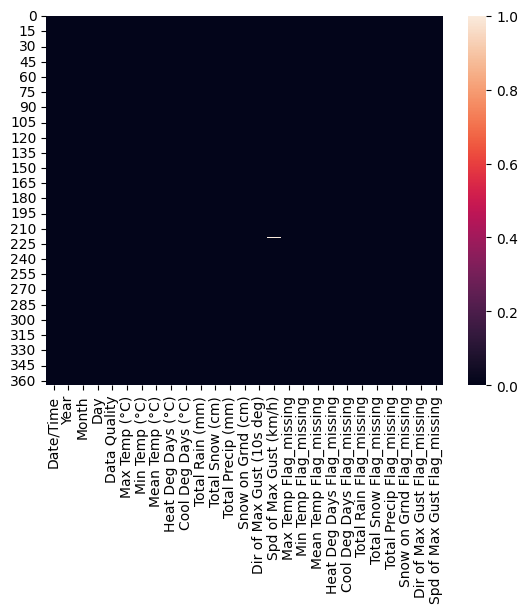

In [46]:
sns.heatmap(weather_data.isnull())

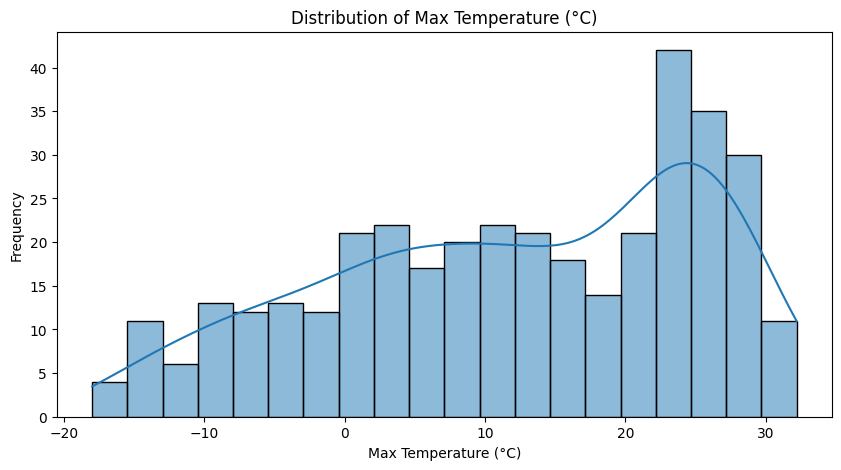

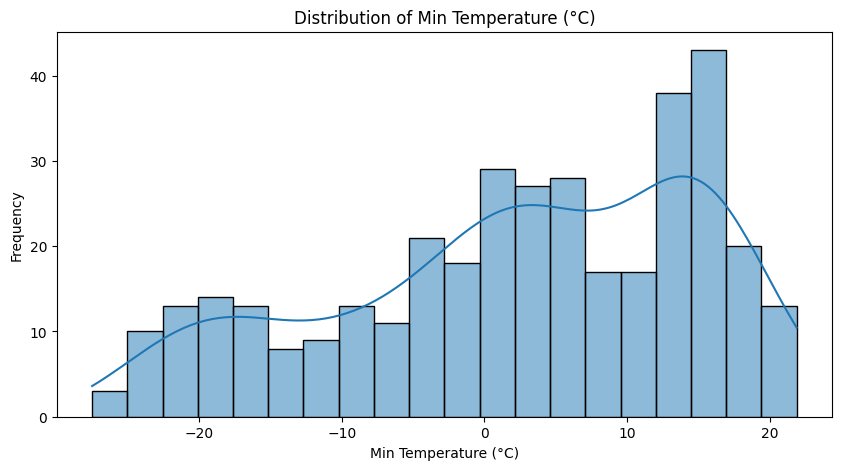

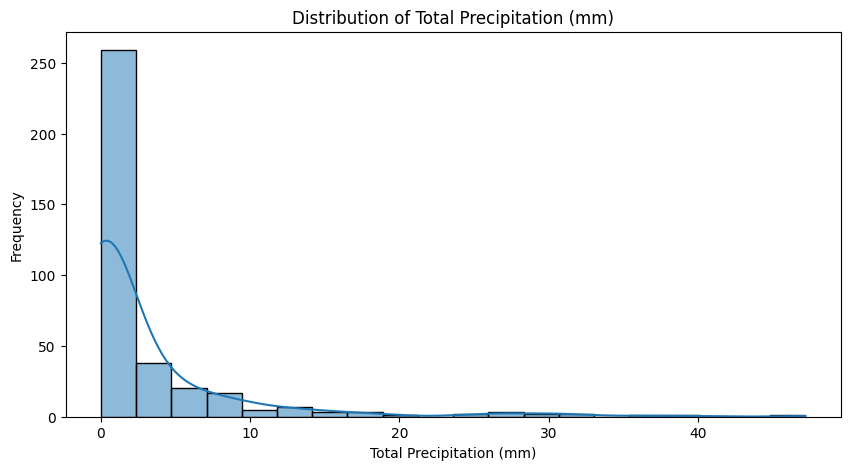

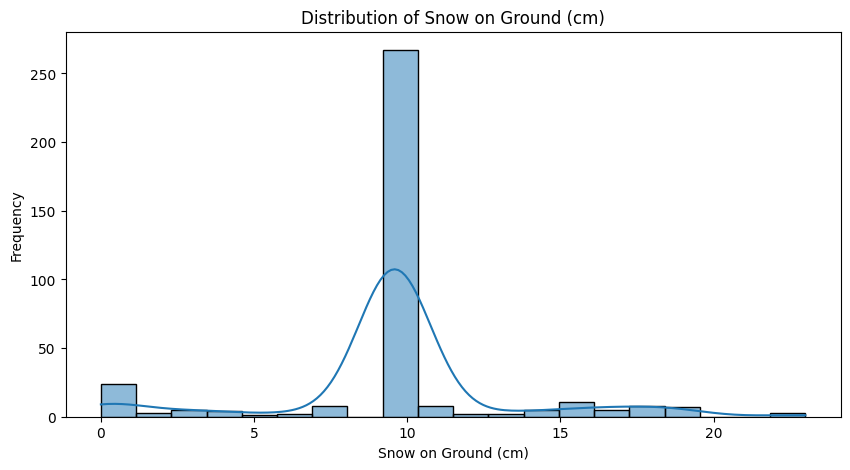

In [47]:
# Univariate Analysis
import matplotlib.pyplot as plt
import seaborn as sns

# Plot a histogram for Max Temperature (°C)
plt.figure(figsize=(10, 5))
sns.histplot(data=weather_data, x='Max Temp (°C)', bins=20, kde=True)
plt.title('Distribution of Max Temperature (°C)')
plt.xlabel('Max Temperature (°C)')
plt.ylabel('Frequency')
plt.show()

# Plot a histogram for Min Temperature (°C)
plt.figure(figsize=(10, 5))
sns.histplot(data=weather_data, x='Min Temp (°C)', bins=20, kde=True)
plt.title('Distribution of Min Temperature (°C)')
plt.xlabel('Min Temperature (°C)')
plt.ylabel('Frequency')
plt.show()

# Plot a histogram for Total Precipitation (mm)
plt.figure(figsize=(10, 5))
sns.histplot(data=weather_data, x='Total Precip (mm)', bins=20, kde=True)
plt.title('Distribution of Total Precipitation (mm)')
plt.xlabel('Total Precipitation (mm)')
plt.ylabel('Frequency')
plt.show()

# Plot a histogram for Snow on Ground (cm)
plt.figure(figsize=(10, 5))
sns.histplot(data=weather_data, x='Snow on Grnd (cm)', bins=20, kde=True)
plt.title('Distribution of Snow on Ground (cm)')
plt.xlabel('Snow on Ground (cm)')
plt.ylabel('Frequency')
plt.show()

These observations provide insights into the distributions of key weather variables. They help in understanding the weather patterns in the dataset and identifying potential outliers or extreme values in the data, which can be valuable for further analysis or modeling.

<ipython-input-48-5ee240ed4e58>:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr_matrix = weather_data.corr()


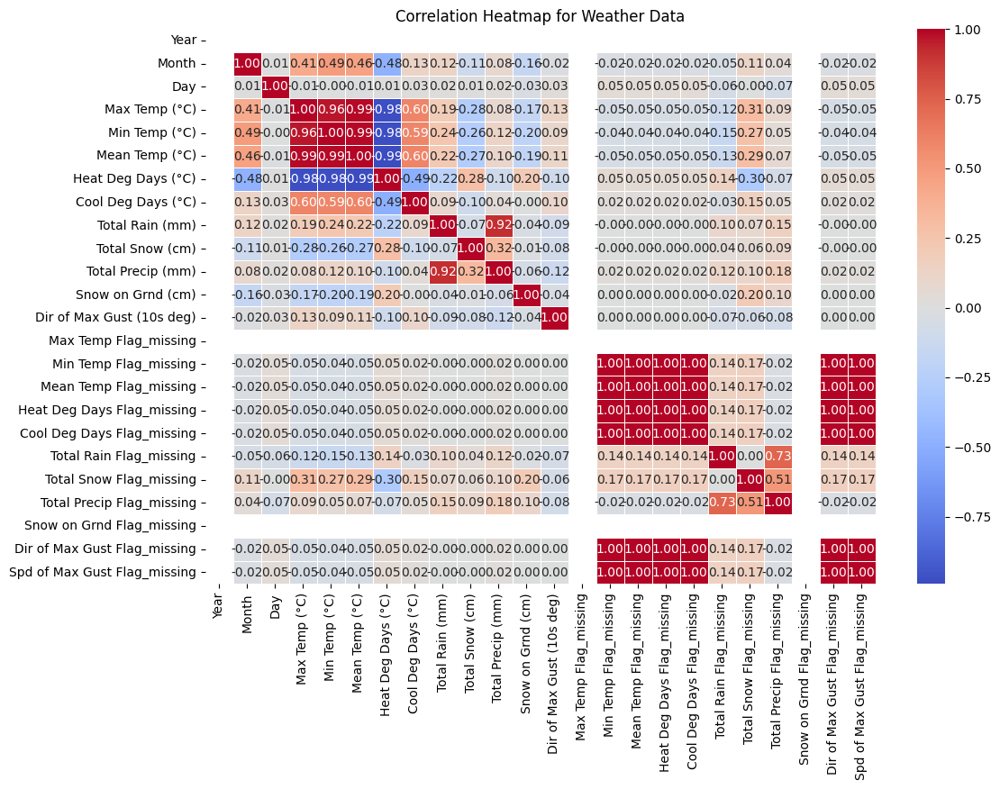

In [48]:
# Correlation matrix for numerical variables
corr_matrix = weather_data.corr()

# Plotting a heatmap of the correlation matrix
plt.figure(figsize=(12, 8))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=0.5)
plt.title('Correlation Heatmap for Weather Data')
plt.show()

The correlation heatmap provides insights into how weather variables relate to each other. Strong correlations may indicate multicollinearity, which can be important to consider in regression or predictive modeling. Additionally, weak correlations suggest that certain variables may not have a significant impact on others.

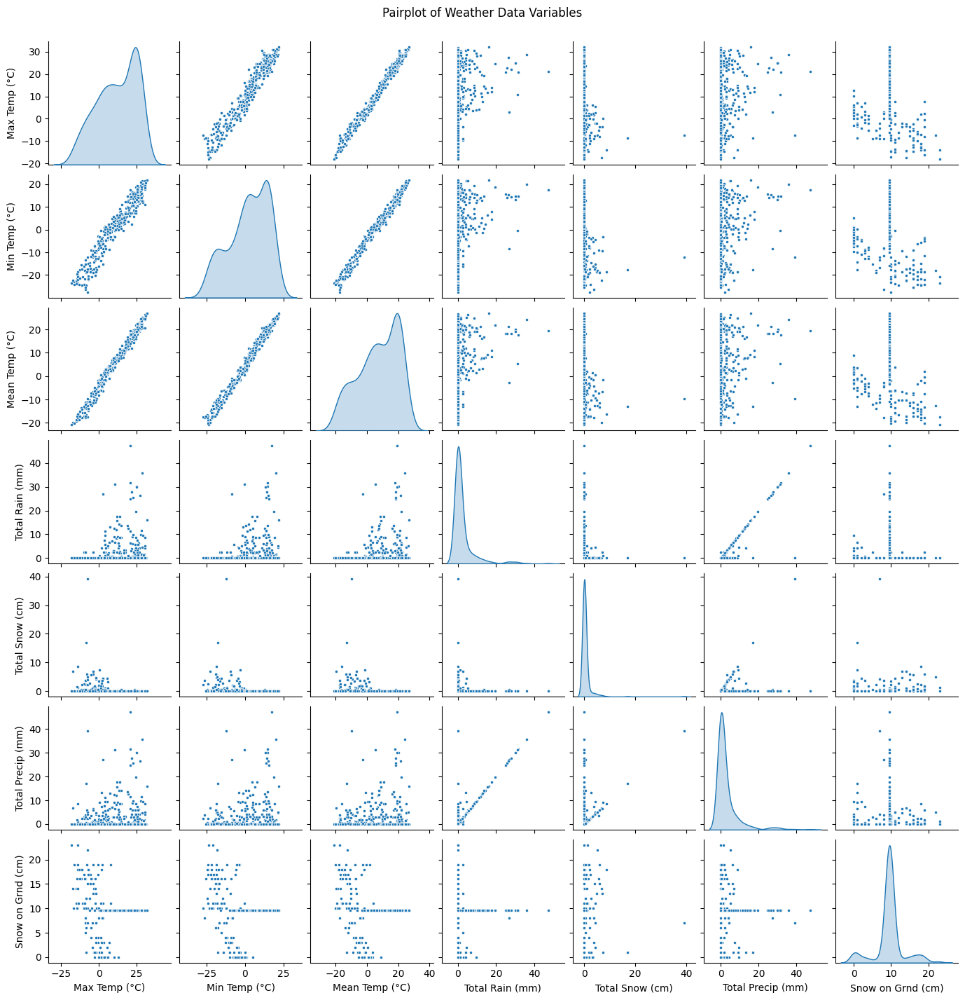

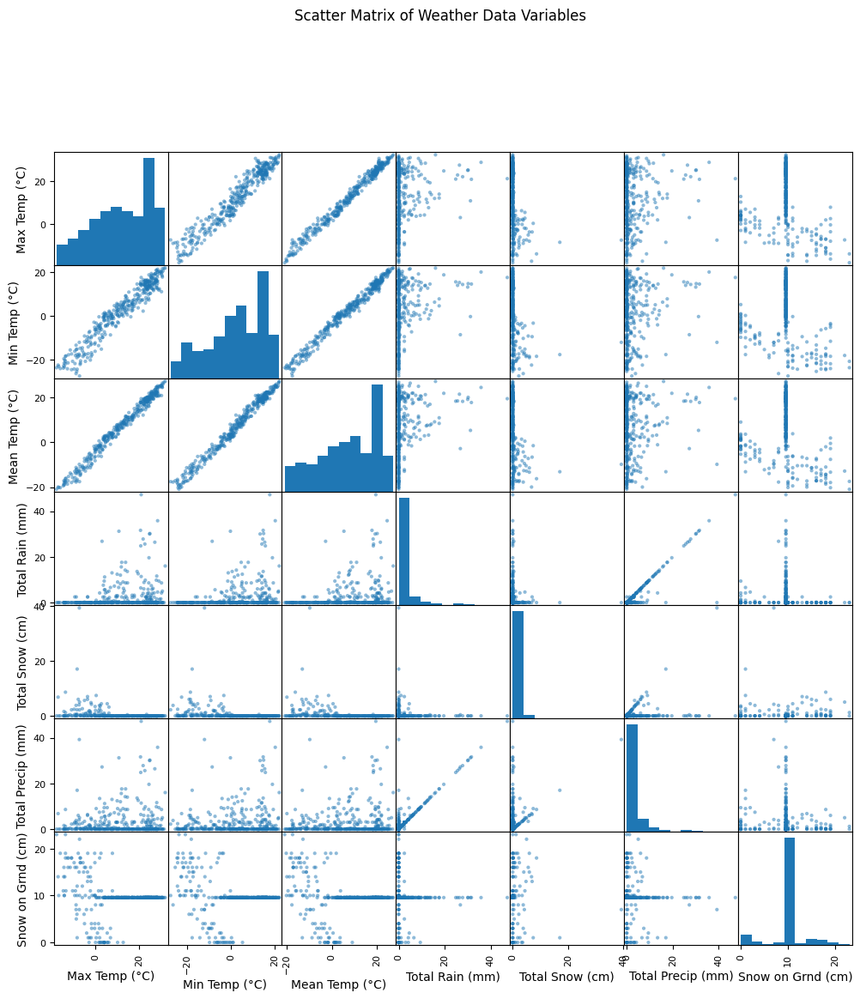

In [49]:
# Multivariate Analysis
# Select a subset of relevant numerical columns for multivariate analysis
selected_cols = ['Max Temp (°C)', 'Min Temp (°C)', 'Mean Temp (°C)', 'Total Rain (mm)', 'Total Snow (cm)', 'Total Precip (mm)', 'Snow on Grnd (cm)', 'Spd of Max Gust (km/h)']

# Create a pairplot to visualize relationships between selected variables
sns.pairplot(weather_data[selected_cols], diag_kind='kde', markers='.', height=2)
plt.suptitle("Pairplot of Weather Data Variables", y=1.02)
plt.show()

# Create a scatter matrix to visualize pairwise relationships and distributions
pd.plotting.scatter_matrix(weather_data[selected_cols], alpha=0.5, figsize=(12, 12))
plt.suptitle("Scatter Matrix of Weather Data Variables", y=1.02)
plt.show()

The pairplot and scatter matrix provide a visual overview of how the selected weather variables relate to each other. These visualizations can help identify potential patterns or outliers in the data.

In [50]:
# Convert date features to the same format (assuming 'Date' is in the format 'yyyy-mm-dd' and 'Date/Time' contains both date and time)
dataset['Date'] = pd.to_datetime(dataset['Date'])
weather_data['Date/Time'] = pd.to_datetime(weather_data['Date/Time'])

# Merge the datasets based on the common 'Date' feature
merged_data = pd.merge(dataset,weather_data, left_on='Date', right_on='Date/Time')


In [51]:
# Select relevant features to append from weather_data
selected_weather_features = ['Max Temp (°C)', 'Min Temp (°C)', 'Total Precip (mm)', 'Spd of Max Gust (km/h)']

# Append the selected weather features to rental_checkpoint_data
for feature in selected_weather_features:
    dataset[feature] = merged_data[feature]

In [71]:
# Handle missing values by replacing non-numeric characters with NaN
dataset.replace('<31', np.nan, inplace=True)

# Convert columns to numeric
dataset[selected_weather_features] = dataset[selected_weather_features].apply(pd.to_numeric,errors='coerce')

In [72]:
# Handle missing values if any
dataset.fillna(dataset.mean(), inplace=True)

<ipython-input-72-7e5b75ccaf69>:2: FutureWarning: DataFrame.mean and DataFrame.median with numeric_only=None will include datetime64 and datetime64tz columns in a future version.
  dataset.fillna(dataset.mean(), inplace=True)
<ipython-input-72-7e5b75ccaf69>:2: FutureWarning: The default value of numeric_only in DataFrame.mean is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.
  dataset.fillna(dataset.mean(), inplace=True)


In [73]:
# Split the data into training and test sets
X = dataset.drop(columns=['TargetVariable','Date','Time'])  # Features
y = dataset['TargetVariable']  # Target variable

In [74]:
X

,check_point0,check_point1,check_point2,check_point3,check_point4,check_point5,check_point6,check_point7,check_point8,check_point9,...,check_point15,check_point16,check_point17,check_point18,check_point19,check_point20,Max Temp (°C),Min Temp (°C),Total Precip (mm),Spd of Max Gust (km/h)
0,58,12,4,17,33.000000,49,21,16,16,2090.25,...,3,8.425994,17,78,21,6,-3.0,-7.6,1.80000,63.000000
1,75,7,5,15,30.000000,113,27,9,32,2090.25,...,13,8.425994,11,57,77,4,-14.2,-20.2,0.00000,35.000000
2,79,7,3,7,30.000000,107,36,12,18,2090.25,...,5,8.425994,14,174,40,5,-3.4,-17.3,0.20000,46.190283
3,10,1,21,0,2.397895,35,29,1,0,2090.25,...,1,8.425994,1,20,6,0,2.0,-6.7,0.00000,43.000000
4,42,0,2,0,27.000000,90,21,1,1,2090.25,...,20,8.425994,0,41,56,10,19.3,7.6,0.00000,46.190283
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
314,3044,1931,2828,1393,4.510150,3603,1754,1142,2342,3997.00,...,338,8.310415,1534,1527,2860,356,10.8,4.0,0.20000,46.190283
315,1751,930,1670,888,4.510150,2048,700,675,1566,2945.00,...,180,7.756623,960,955,1777,198,14.0,6.4,0.00000,70.000000
316,1818,906,1711,873,4.510150,2115,634,477,1522,1693.00,...,204,2628.000000,978,1040,1727,258,9.4,0.9,2.99831,48.000000
317,979,759,978,322,4.510150,1112,290,310,601,604.00,...,70,7.537430,640,805,737,73,4.1,-0.2,0.00000,50.000000


In [75]:
y

0        531.0
1        804.0
2        774.0
3        158.0
4        371.0
        ...   
314    40940.0
315    24175.0
316    23331.0
317    13298.0
318    13598.0
Name: TargetVariable, Length: 319, dtype: float64

In [76]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [77]:
# Train a regression model (Linear Regression for example)
model = LinearRegression()
model.fit(X_train, y_train)

LinearRegression()

In [78]:
# Make predictions on the test set
y_pred = model.predict(X_test)

In [79]:
# Evaluate the model using Mean Absolute Error (MAE)
mae = mean_absolute_error(y_test, y_pred)
print(f'Mean Absolute Error: {mae}')

Mean Absolute Error: 756.6742843119551


In [81]:
# Implement Deep learning Algorithm

import numpy as np
import pandas as pd
import tensorflow as tf
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_absolute_error, mean_absolute_percentage_error
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout
from tensorflow.keras.optimizers import Adam

In [84]:
# Handle missing values by replacing non-numeric characters with NaN
dataset.replace('<31', np.nan, inplace=True)

# Convert columns to numeric
dataset[selected_weather_features] = dataset[selected_weather_features].apply(pd.to_numeric,errors='coerce')

In [85]:
# Handle missing values if any
dataset.fillna(dataset.mean(), inplace=True)

<ipython-input-85-7e5b75ccaf69>:2: FutureWarning: DataFrame.mean and DataFrame.median with numeric_only=None will include datetime64 and datetime64tz columns in a future version.
  dataset.fillna(dataset.mean(), inplace=True)
<ipython-input-85-7e5b75ccaf69>:2: FutureWarning: The default value of numeric_only in DataFrame.mean is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.
  dataset.fillna(dataset.mean(), inplace=True)


In [86]:
# Split the data into training and test sets
X = dataset.drop(columns=['TargetVariable','Date','Time'])  # Features
y = dataset['TargetVariable']  # Target variable

In [87]:
# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Standardize features (optional but can help with convergence)
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

In [88]:
# Build a neural network model
model = Sequential()
model.add(Dense(128, activation='relu', input_shape=(X_train.shape[1],)))
model.add(Dropout(0.2))  # Dropout layer to reduce overfitting
model.add(Dense(64, activation='relu'))
model.add(Dense(1, activation='linear'))  # Output layer for regression

In [89]:
# Compile the model
model.compile(optimizer=Adam(learning_rate=0.001), loss='mean_absolute_error')

In [90]:
# Train the model
model.fit(X_train, y_train, epochs=100, batch_size=32, verbose=1, validation_split=0.2)

Epoch 1/100
7/7 [==============================] - 4s 60ms/step - loss: 30222.0898 - val_loss: 30753.6738
Epoch 2/100
7/7 [==============================] - 0s 14ms/step - loss: 30220.6348 - val_loss: 30752.0098
Epoch 3/100
7/7 [==============================] - 0s 14ms/step - loss: 30218.8301 - val_loss: 30749.8340
Epoch 4/100
7/7 [==============================] - 0s 14ms/step - loss: 30216.5273 - val_loss: 30746.7148
Epoch 5/100
7/7 [==============================] - 0s 16ms/step - loss: 30213.2344 - val_loss: 30742.3848
Epoch 6/100
7/7 [==============================] - 0s 13ms/step - loss: 30208.6250 - val_loss: 30736.3750
Epoch 7/100
7/7 [==============================] - 0s 14ms/step - loss: 30202.7012 - val_loss: 30728.2812
Epoch 8/100
7/7 [==============================] - 0s 13ms/step - loss: 30194.0312 - val_loss: 30717.5273
Epoch 9/100
7/7 [==============================] - 0s 14ms/step - loss: 30183.7480 - val_loss: 30703.5586
Epoch 10/100
7/7 [============================

In [91]:
# Evaluate the model on the test set
y_pred = model.predict(X_test)

2/2 [==============================] - 0s 8ms/step


In [92]:
# Calculate MAE and MAPE
mae = mean_absolute_error(y_test, y_pred)
mape = mean_absolute_percentage_error(y_test, y_pred)

print(f"Mean Absolute Error (MAE): {mae}")
print(f"Mean Absolute Percentage Error (MAPE): {mape * 100:.2f}%")

Mean Absolute Error (MAE): 6213.922110557556
Mean Absolute Percentage Error (MAPE): 93.16%


The Mean Absolute Error (MAE) of 6213.92 and the Mean Absolute Percentage Error (MAPE) of 93.16% suggest that the deep learning model's performance on your dataset is not ideal. The MAPE indicates that, on average, the predictions are off by approximately 93.16% from the actual values

In [93]:
X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.3, random_state=42)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)

In [94]:
# Define the model-building function
def build_model(hp):
    model = keras.Sequential()
    model.add(layers.Input(shape=(X_train.shape[1],)))

    # Tune the number of layers and units per layer
    for i in range(hp.Int('num_layers', 2, 5)):  # 2 to 5 layers
        model.add(layers.Dense(units=hp.Int('units_' + str(i), 32, 512, 32), activation='relu'))

    # Output layer
    model.add(layers.Dense(1, activation='linear'))

    # Tune the learning rate
    hp_learning_rate = hp.Choice('learning_rate', values=[1e-2, 1e-3, 1e-4])

    # Compile the model with the specified learning rate
    model.compile(optimizer=keras.optimizers.Adam(learning_rate=hp_learning_rate),
                  loss='mean_absolute_error',  # Use MAE as the loss function
                  metrics=['mean_absolute_error'])

    return model

In [99]:
from tensorflow import keras
from tensorflow.keras import layers
!pip install keras-tuner
from kerastuner.tuners import RandomSearch

# Initialize the tuner
tuner = RandomSearch(
    build_model,
    objective='val_mean_absolute_error',  # Choose the validation MAE as the objective to minimize
    max_trials=10,  # Number of hyperparameter combinations to try
    directory='my_tuning_dir',  # Directory to store results
    project_name='my_regression_tuning'  # Name of the tuning project
)

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 176.1/176.1 kB 3.3 MB/s eta 0:00:00


<ipython-input-99-6b535a535f14>:4: DeprecationWarning: `import kerastuner` is deprecated, please use `import keras_tuner`.
  from kerastuner.tuners import RandomSearch


In [100]:
# Perform the hyperparameter search
tuner.search(X_train, y_train, epochs=10, validation_data=(X_val, y_val))

Trial 10 Complete [00h 00m 03s]
val_mean_absolute_error: 2342.69482421875

Best val_mean_absolute_error So Far: 680.7167358398438
Total elapsed time: 00h 00m 38s


In [101]:
# Get the best hyperparameter configuration
best_hparams = tuner.get_best_hyperparameters(num_trials=1)[0]

In [102]:
# Build the final model with the best hyperparameters
final_model = tuner.hypermodel.build(best_hparams)

In [103]:
# Train the final model on the entire dataset
final_model.fit(X_train, y_train, epochs=50, verbose=2)

Epoch 1/50
7/7 - 1s - loss: 25193.6621 - mean_absolute_error: 25193.6621 - 1s/epoch - 207ms/step
Epoch 2/50
7/7 - 0s - loss: 9954.2178 - mean_absolute_error: 9954.2178 - 89ms/epoch - 13ms/step
Epoch 3/50
7/7 - 0s - loss: 4454.1841 - mean_absolute_error: 4454.1841 - 87ms/epoch - 12ms/step
Epoch 4/50
7/7 - 0s - loss: 2741.5212 - mean_absolute_error: 2741.5212 - 76ms/epoch - 11ms/step
Epoch 5/50
7/7 - 0s - loss: 2140.6047 - mean_absolute_error: 2140.6047 - 81ms/epoch - 12ms/step
Epoch 6/50
7/7 - 0s - loss: 1858.4974 - mean_absolute_error: 1858.4974 - 74ms/epoch - 11ms/step
Epoch 7/50
7/7 - 0s - loss: 1528.2544 - mean_absolute_error: 1528.2544 - 81ms/epoch - 12ms/step
Epoch 8/50
7/7 - 0s - loss: 1115.1499 - mean_absolute_error: 1115.1499 - 80ms/epoch - 11ms/step
Epoch 9/50
7/7 - 0s - loss: 810.9348 - mean_absolute_error: 810.9348 - 85ms/epoch - 12ms/step
Epoch 10/50
7/7 - 0s - loss: 825.6501 - mean_absolute_error: 825.6501 - 78ms/epoch - 11ms/step
Epoch 11/50
7/7 - 0s - loss: 747.6488 - me

In [104]:
# Evaluate the final model
test_loss, test_mae = final_model.evaluate(X_test, y_test)
print(f"Test MAE: {test_mae:.2f}")

2/2 [==============================] - 0s 8ms/step - loss: 576.8535 - mean_absolute_error: 576.8535
Test MAE: 576.85


A Test Mean Absolute Error (MAE) of 576.85 indicates that your deep learning model is performing well on the test data. A lower MAE suggests that the model's predictions are close to the actual target values.

In [105]:
# You can save the final model for later use if needed
final_model.save('final_model.h5')

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(
